# Exploración de datos - Estación de meteorológica

In [1]:
%load_ext autoreload
%autoreload 2

import sys
import os

project_path = os.path.abspath('../')
sys.path.insert(1, project_path)

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
sns.set(style="darkgrid")
sns.set_context('talk')

from src.utils import get_project_root
from src.data.make_dataset import get_minma_data
from src.eda.processing import get_SO2_peaks, get_SO2_limit, filter_by_dates, dates_to_hours, to_season, daily_stats, df_counts
from src.eda.visualization import hist_plot, conf_matrix, lag_plot, plot_peak_counts,\
                                    plot_temp, cumdistr_comparison, cumdistr_comparacion_horaria,\
                                    plot_estabilidad_TDiff, plot_estabilidad_SigDir
from src.eda.trends import *
import dataframe_image as dfi

## Carga de datos 

### Datos

In [5]:
data_df = pd.read_excel(get_project_root() / 'data' / 'raw' / 'Torre Meteo Codelco Ventanas.xlsx').set_index('date')
data_df['T_diff'] = 100*(data_df['T_40'] - data_df['T_10']) / 30

## Conteo de datos

In [6]:
# print(f'Rango de datos desde {data_df.index[0]} hasta {data_df.index[-1]}')
# print(df_counts(data_df).to_markdown())

Rango de datos desde 2017-01-01 01:00:00 hasta 2022-09-27 18:00:00
|           |   N° datos |   N° datos nulos |   N° datos esperados |   Datos respecto al esperado [%] | Tipo de datos   |
|:----------|-----------:|-----------------:|---------------------:|---------------------------------:|:----------------|
| T_10      |      49422 |              876 |                50298 |                            98.26 | float64         |
| T_20      |      49452 |              846 |                50298 |                            98.32 | float64         |
| T_40      |      49320 |              978 |                50298 |                            98.06 | float64         |
| WD_10     |      49261 |             1037 |                50298 |                            97.94 | float64         |
| WD_20     |      49475 |              823 |                50298 |                            98.36 | float64         |
| WD_40     |      49248 |             1050 |                50298 |                            97.91 | float64         |
| WS_10     |      49261 |             1037 |                50298 |                            97.94 | float64         |
| WS_20     |      49475 |              823 |                50298 |                            98.36 | float64         |
| WS_40     |      49248 |             1050 |                50298 |                            97.91 | float64         |
| SigDir_10 |      49533 |              765 |                50298 |                            98.48 | float64         |
| SigDir_20 |      49533 |              765 |                50298 |                            98.48 | float64         |
| SigDir_40 |      49533 |              765 |                50298 |                            98.48 | float64         |
| HR_10     |      49414 |              884 |                50298 |                            98.24 | float64         |
| HR_20     |      45897 |             4401 |                50298 |                            91.25 | float64         |
| HR_40     |      49481 |              817 |                50298 |                            98.38 | float64         |
| P_20      |      49352 |              946 |                50298 |                            98.12 | float64         |
| T_diff    |      49264 |             1034 |                50298 |                            97.94 | float64         |

## Visualización inicial

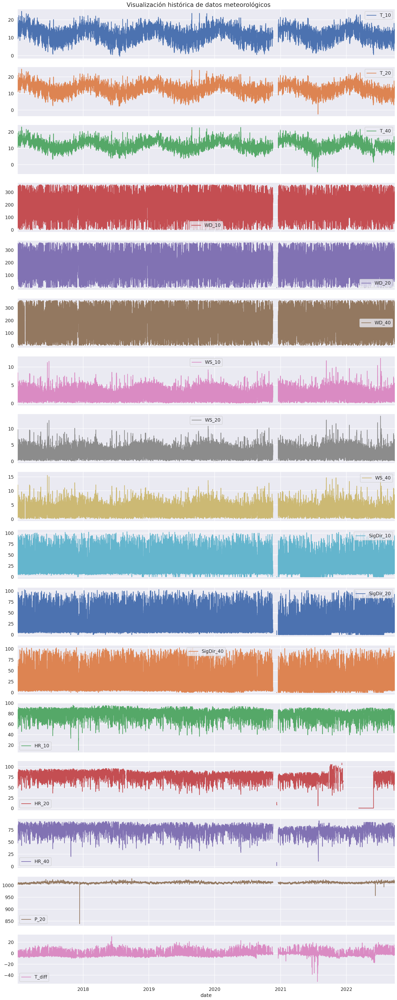

In [8]:
data_df.plot(figsize=(20,50), subplots=True)
plt.suptitle('Visualización histórica de datos meteorológicos', y=0.99)
plt.tight_layout()
plt.show()

## Estadísticas

### Histogramas

/home/agonzalez/projects/mds7201-minma-so2/src/eda/visualization.py:34: UserWarning: FixedFormatter should only be used together with FixedLocator
  plt.suptitle('Visualización de la distribución de datos')


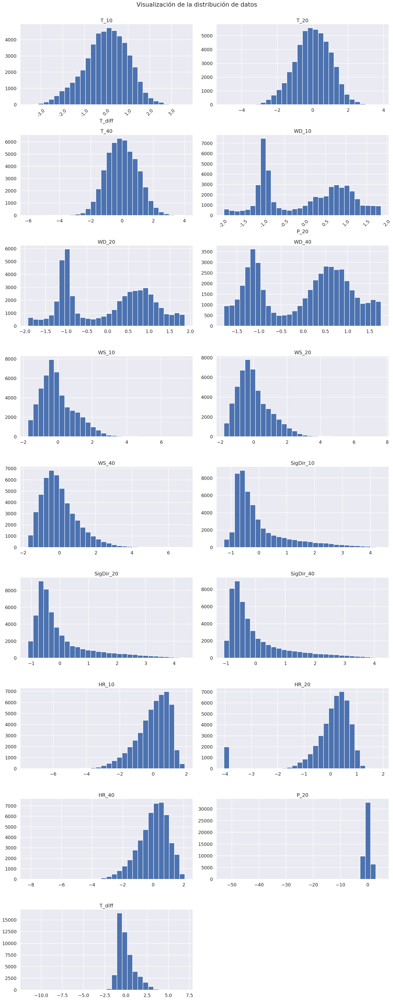

In [26]:
# args = {'xscale':'log', 'yscale':'log'} # -> Descomentar para aplica escala logaritmica
# xlabel_list = [str(a) + b for a,b in zip(data_df.columns.tolist(),[' [ppm/hr]']*data_df.shape[1])]
data_df_norm = (data_df - data_df.mean()) / data_df.std()
hist_plot(data_df_norm, xlabel_list=data_df.columns) #, **args) -> Opcional para escala logaritmica, u otros parámetros

### Resumen estadístico

In [27]:
data_df.describe()

,T_10,T_20,T_40,WD_10,WD_20,WD_40,WS_10,WS_20,WS_40,SigDir_10,SigDir_20,SigDir_40,HR_10,HR_20,HR_40,P_20,T_diff
count,49422.000000,49452.000000,49320.000000,49261.000000,49475.000000,49248.000000,49261.000000,49475.000000,49248.000000,49533.000000,49533.000000,49533.000000,49414.000000,45897.000000,49481.000000,49352.000000,49264.000000
mean,12.168496,12.868626,12.034148,185.873030,182.788780,181.783896,2.376006,2.624565,3.241442,22.870336,21.055178,20.819240,78.600427,73.962099,74.603799,1012.024566,-0.445841
std,3.482076,3.075376,2.742432,93.905781,94.910287,101.620480,1.363919,1.476153,1.849531,18.339604,18.827131,19.566716,9.098981,18.247236,8.977901,3.277233,4.433932
min,-0.361983,-2.484530,-4.491250,0.006314,0.000017,0.007607,0.010144,0.012034,0.026629,0.000000,0.000000,0.000000,10.182800,0.317567,1.041790,838.845000,-51.698167
25%,9.968373,10.846000,10.099275,93.613200,87.918650,74.849425,1.411540,1.587160,1.924070,10.720000,8.830000,7.747000,73.417625,70.271000,69.341700,1010.000000,-3.351000
50%,12.357600,12.923300,11.964450,202.174000,204.362000,207.862000,2.100590,2.350390,2.904655,16.150000,14.010000,13.230000,80.261700,78.088300,75.765100,1012.000000,-1.625300
75%,14.658750,15.077350,13.961500,268.163000,263.905500,264.219000,3.145330,3.412580,4.203235,28.160000,25.990000,26.740000,85.594600,84.041700,80.978800,1014.000000,1.490000
max,24.737800,24.704800,23.071800,359.995000,359.998000,359.994000,12.428200,13.881300,16.022400,103.200000,103.400000,103.400000,95.978300,108.991000,93.215000,1028.130000,30.405667


### Estabilidad

<img src="../../reports/figures/tabla_estabilidad.png" class="center"/>

#### Estabilidad - T_diff

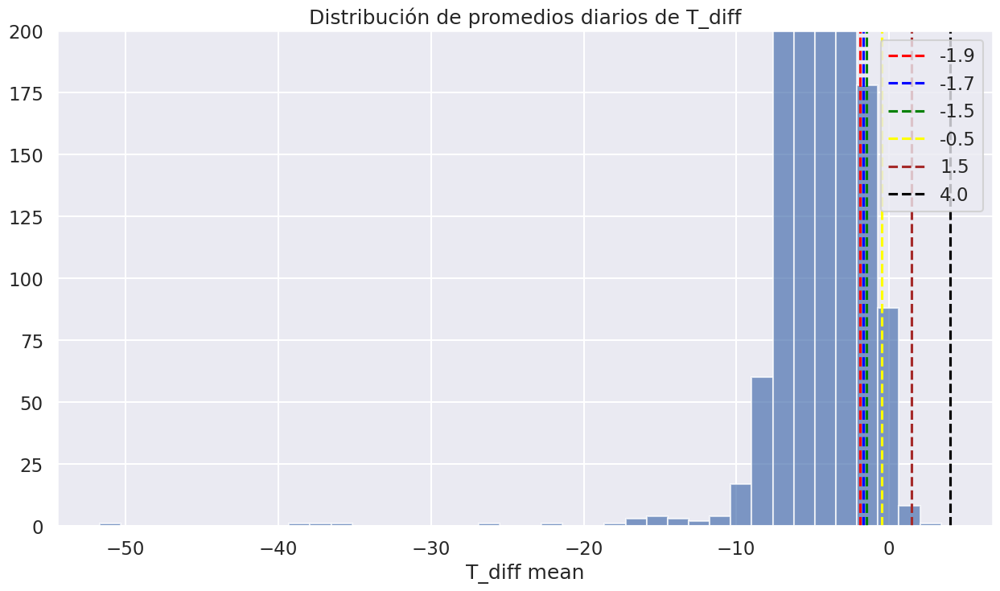

In [18]:
plot_estabilidad_TDiff(data_df)

#### Estabilidad - SigDir

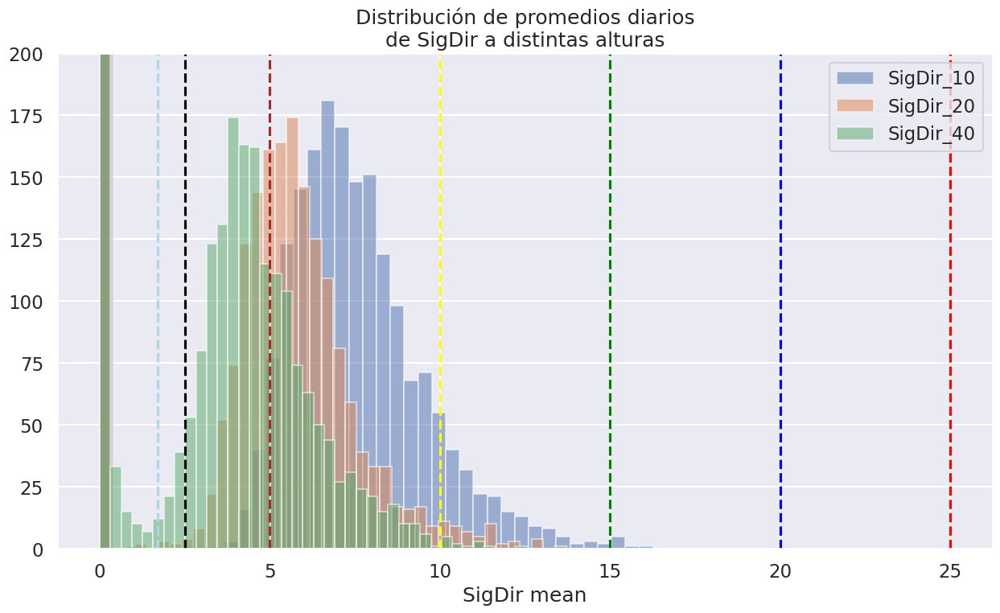

In [16]:
plot_estabilidad_SigDir(data_df)

## Correlaciones entre datos

### Pair plot

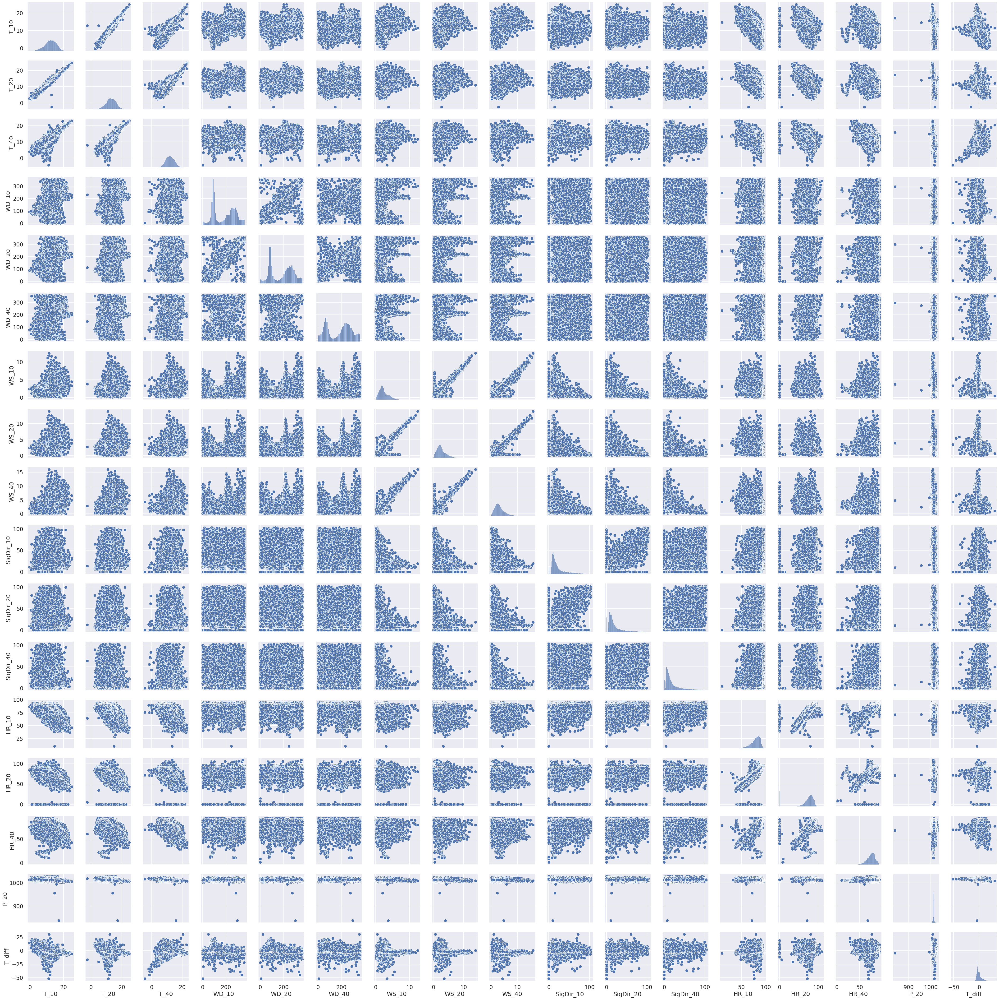

In [28]:
sns.pairplot(data_df)
plt.tight_layout()
plt.show()

### Matriz de confusion

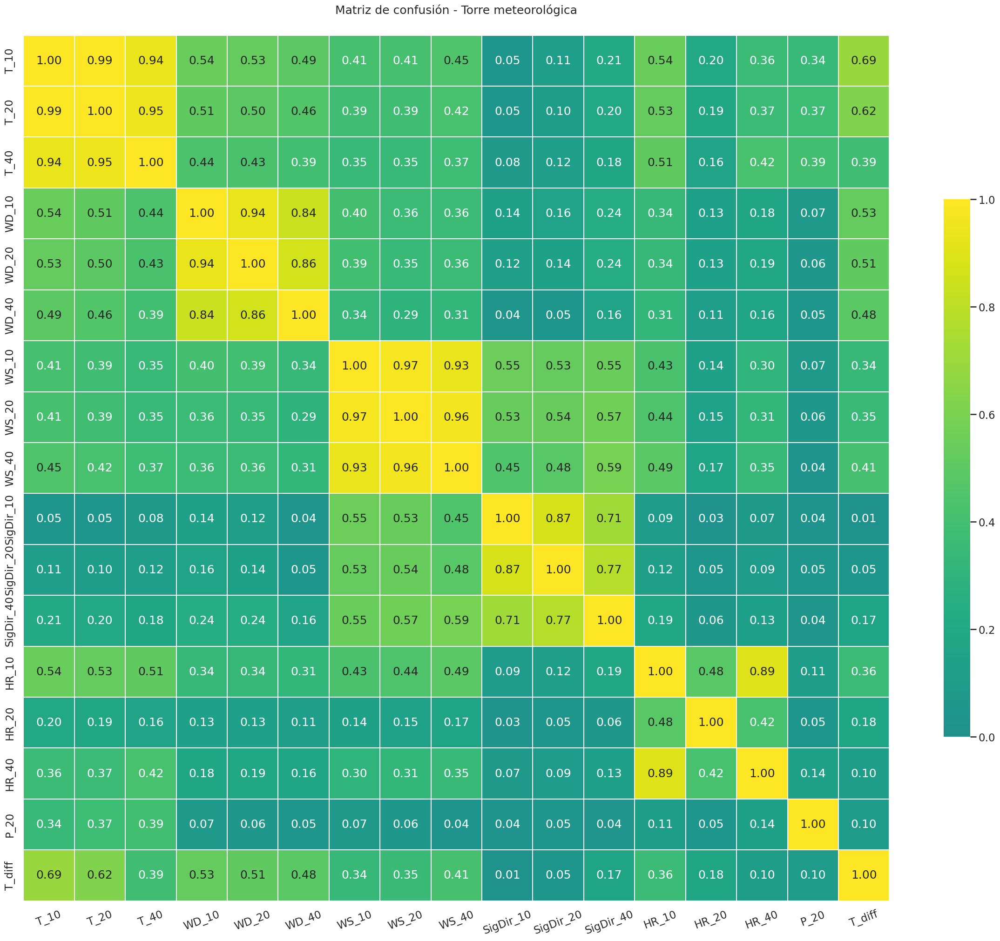

In [29]:
fig, ax = plt.subplots(figsize=(30,30))

conf_matrix(data_df)
ax.set_title('Matriz de confusión - Torre meteorológica', y=1.02)
ax.xaxis.set_ticklabels(ax.get_xticklabels(), rotation=20)
plt.show()

## Lag plots

### 1 hora

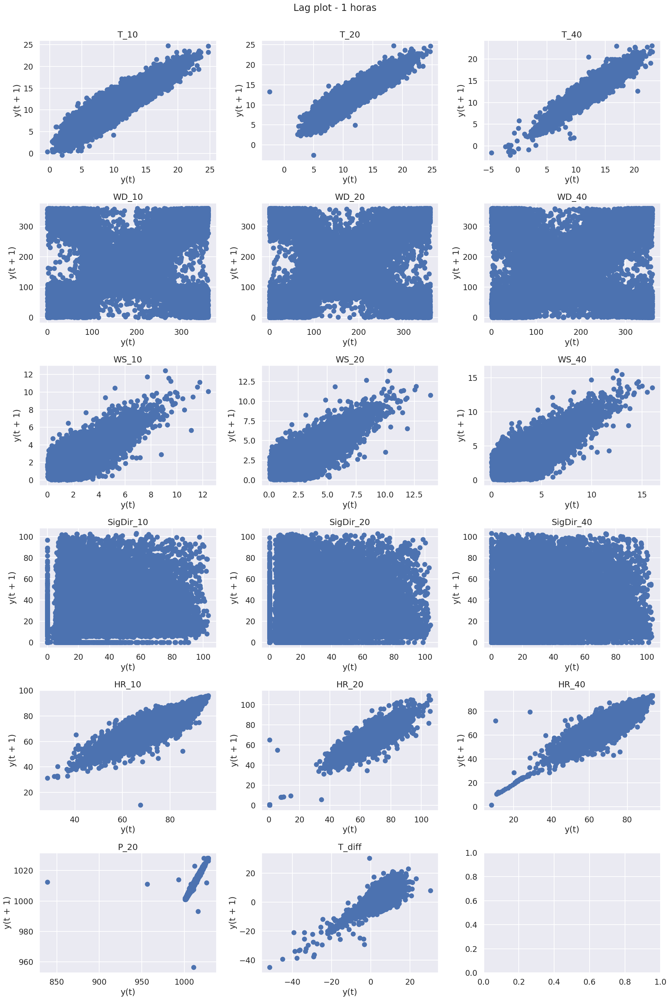

In [35]:
lag_plot(data_df, lag=1, unit='horas')

### 1 día

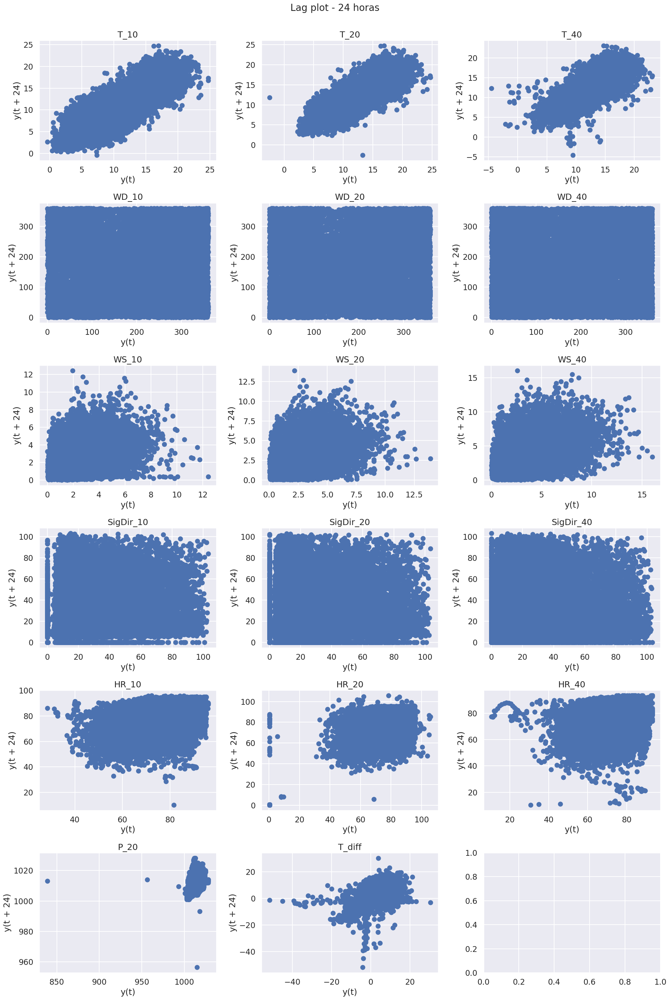

In [36]:
lag_plot(data_df, lag=24, unit='horas')

## Tendencias

In [37]:
data_df.columns

Index(['T_10', 'T_20', 'T_40', 'WD_10', 'WD_20', 'WD_40', 'WS_10', 'WS_20',
       'WS_40', 'SigDir_10', 'SigDir_20', 'SigDir_40', 'HR_10', 'HR_20',
       'HR_40', 'P_20', 'T_diff'],
      dtype='object')

T_20------------------------------------------------------------------------------------------------------------------------------------------------------


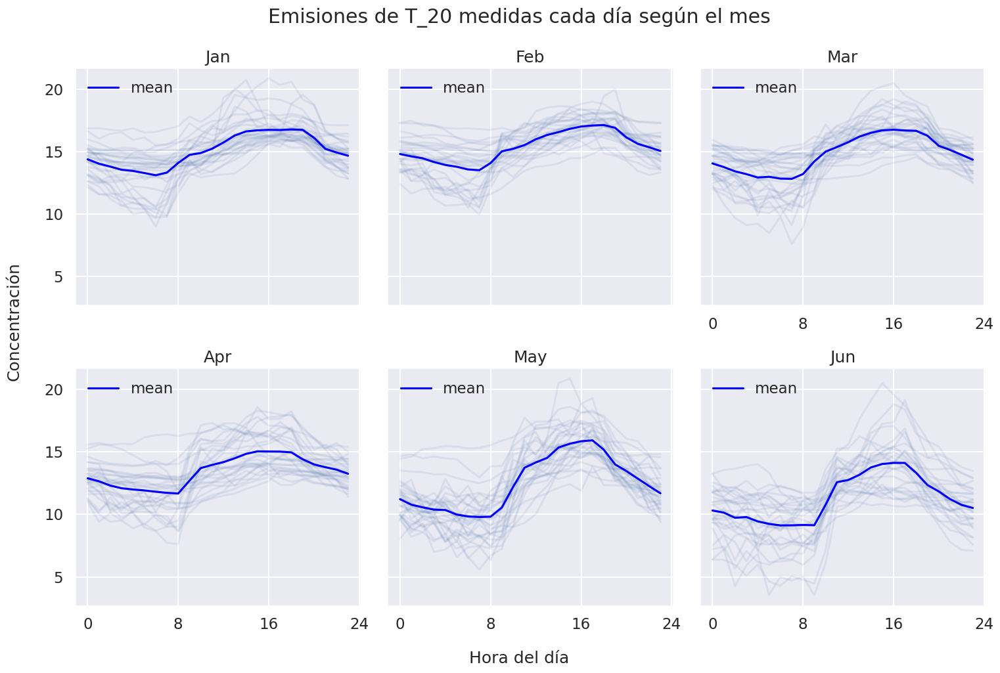

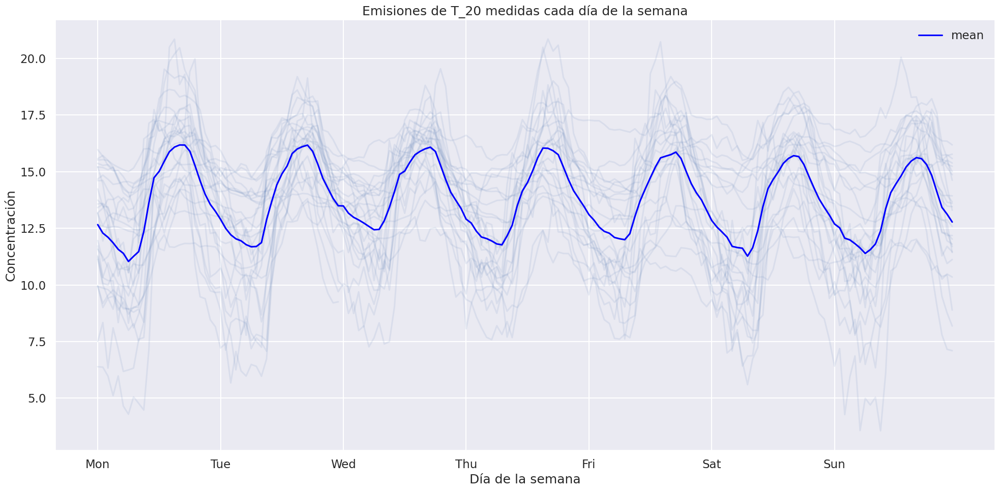

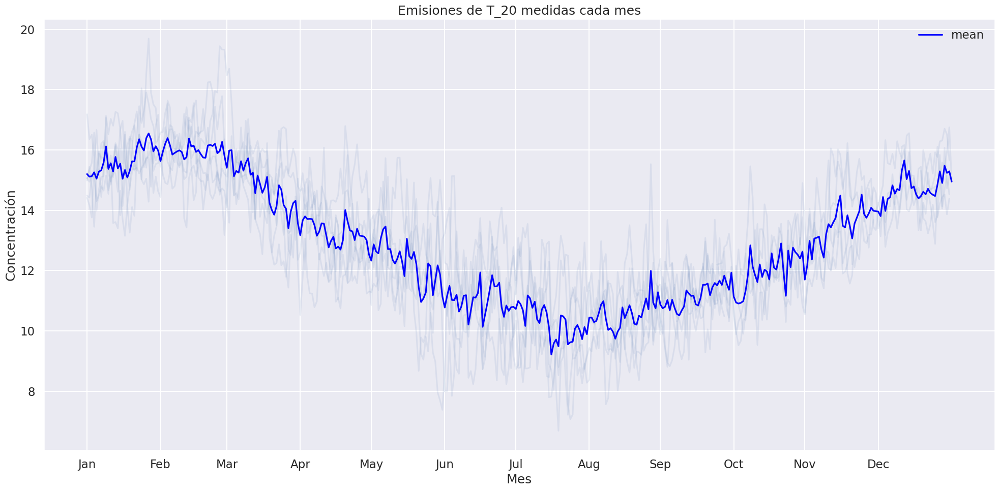

WD_20------------------------------------------------------------------------------------------------------------------------------------------------------


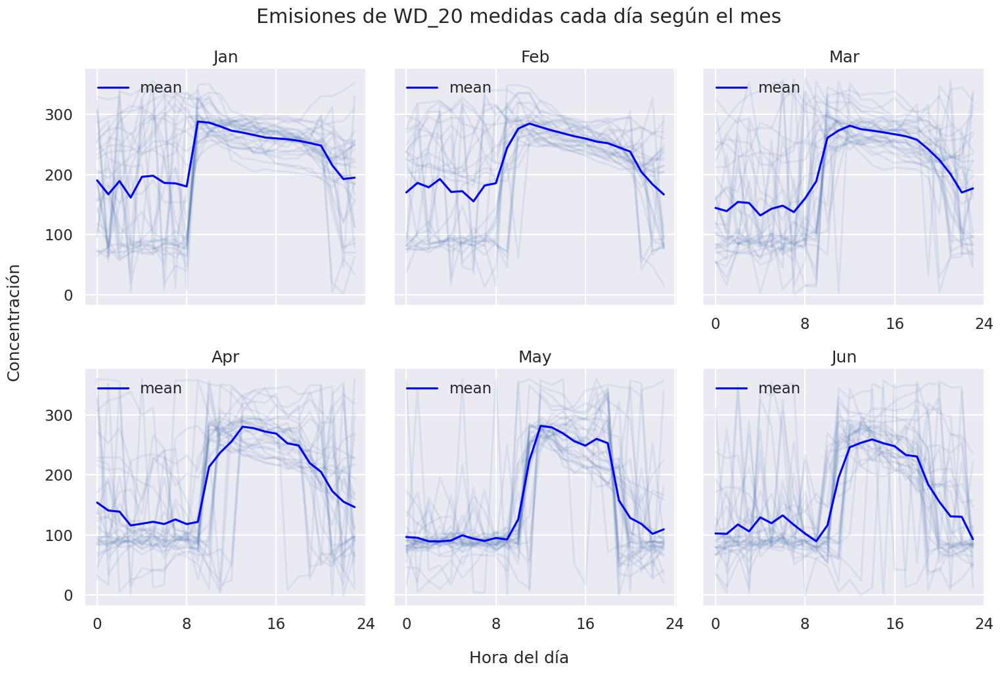

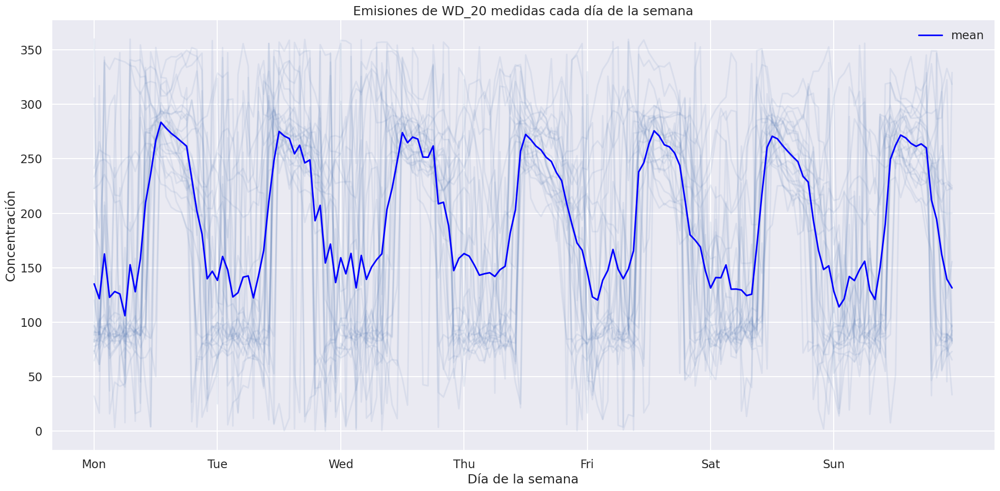

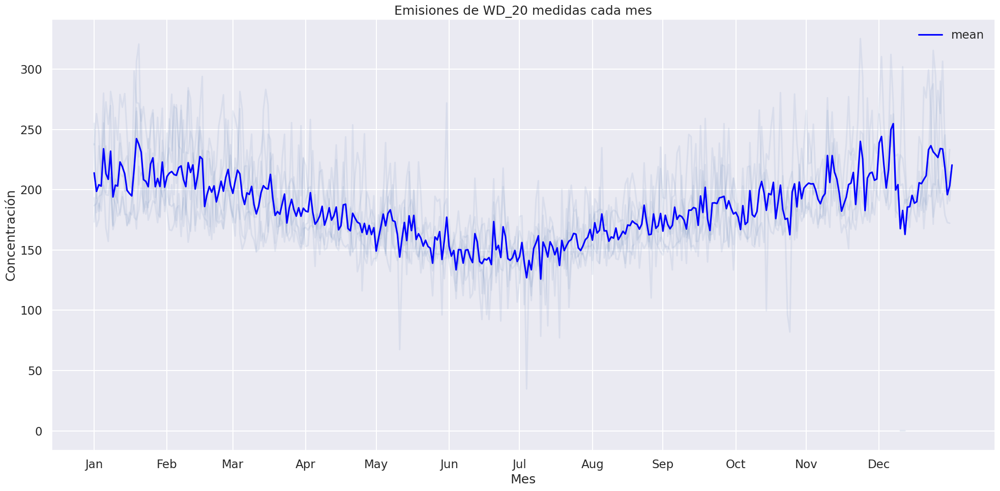

WS_20------------------------------------------------------------------------------------------------------------------------------------------------------


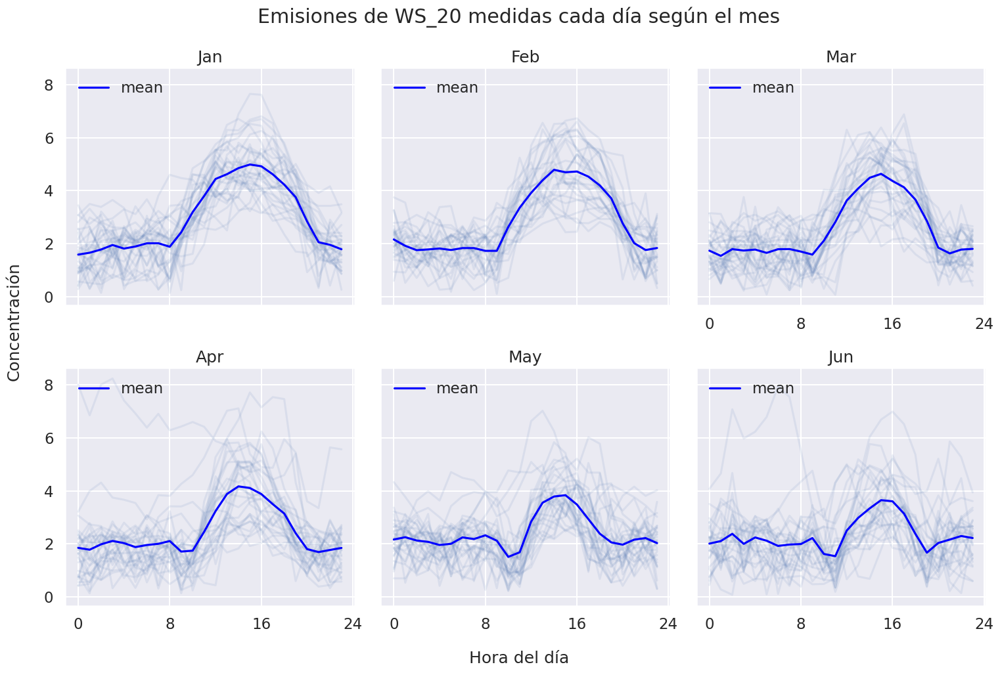

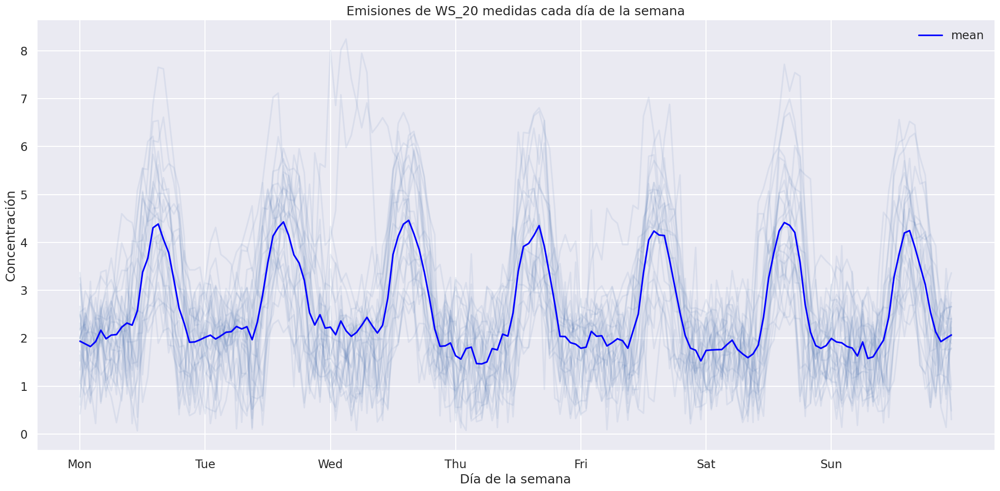

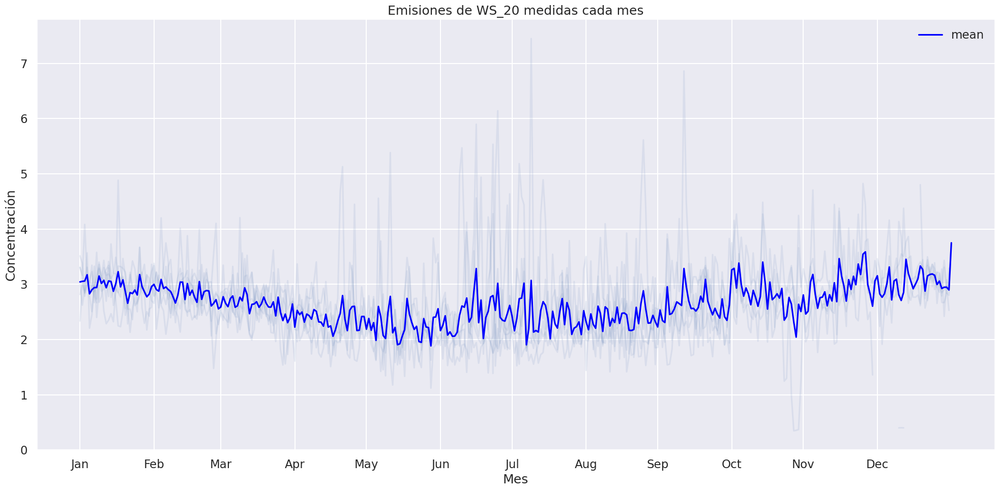

SigDir_20------------------------------------------------------------------------------------------------------------------------------------------------------


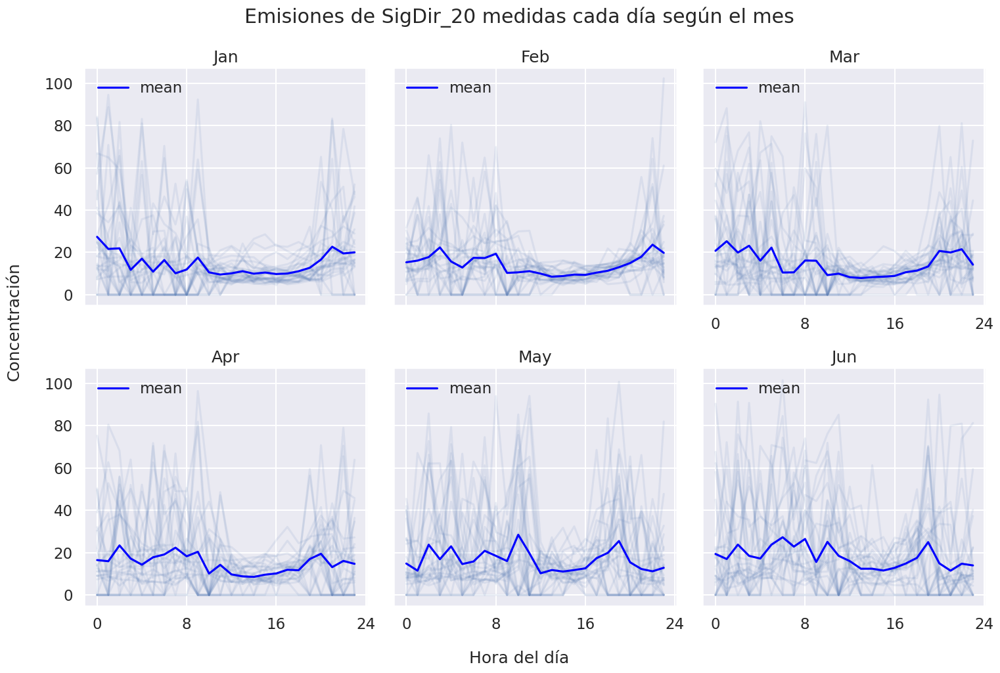

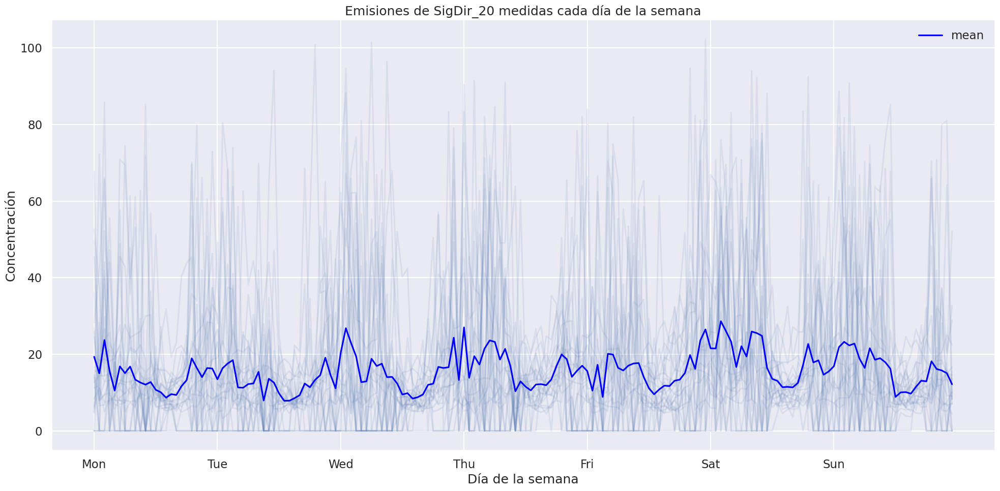

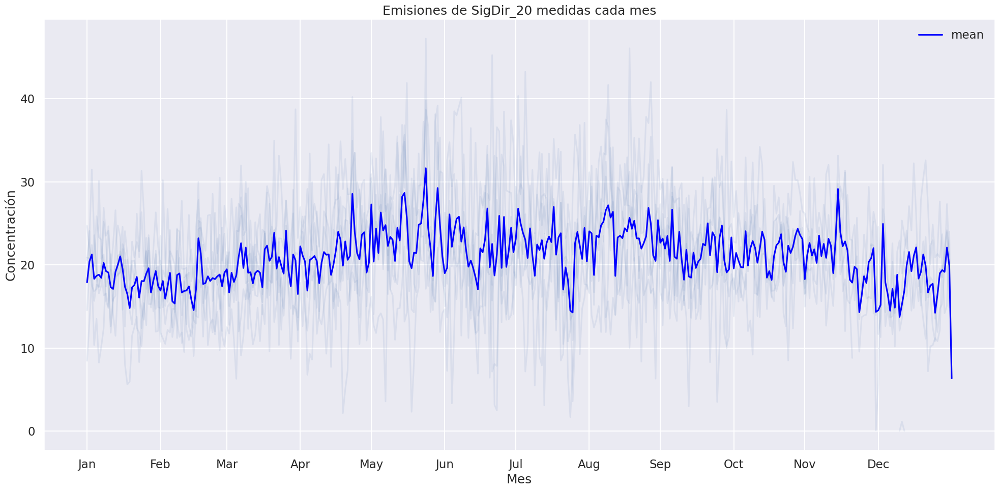

HR_20------------------------------------------------------------------------------------------------------------------------------------------------------


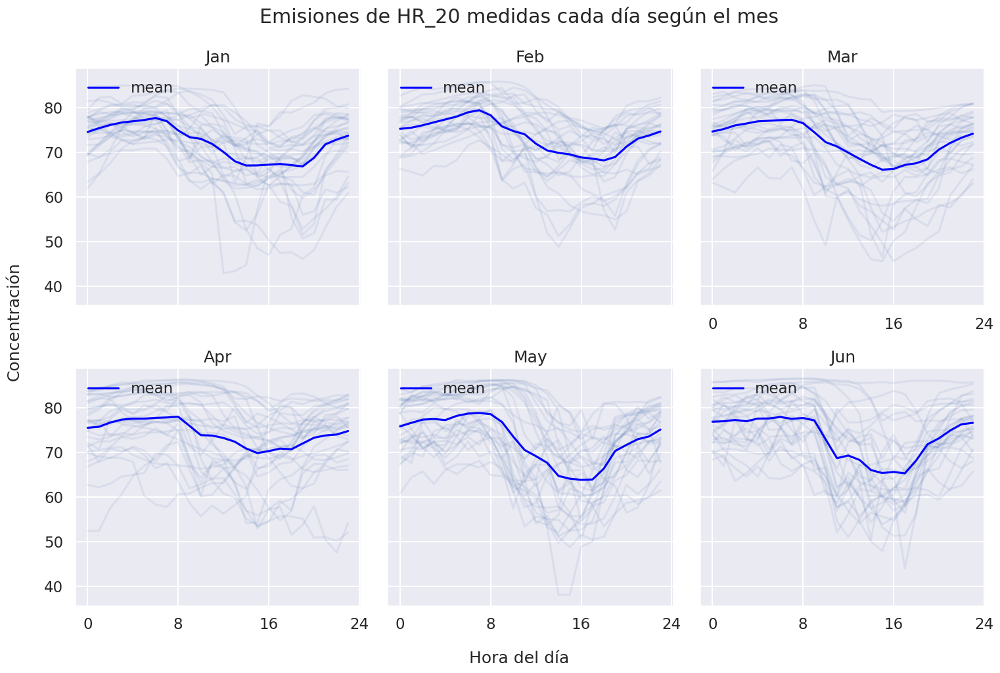

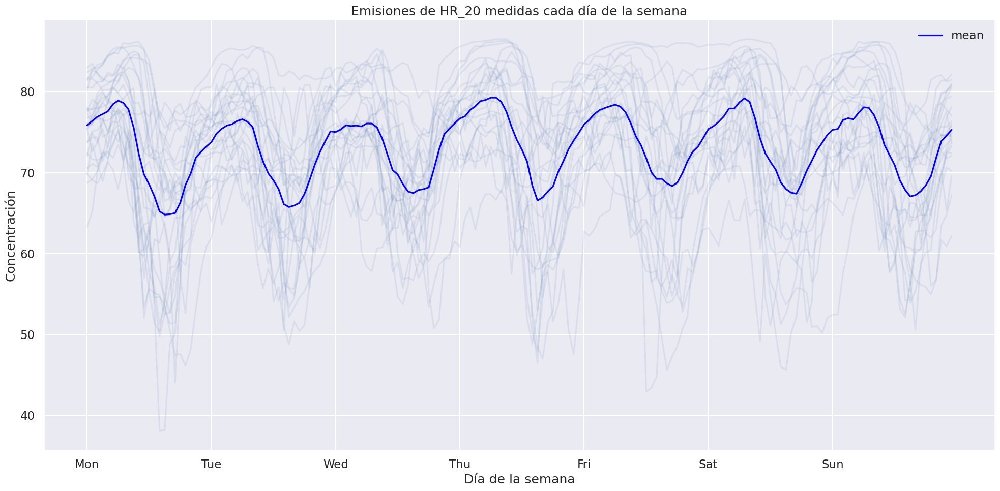

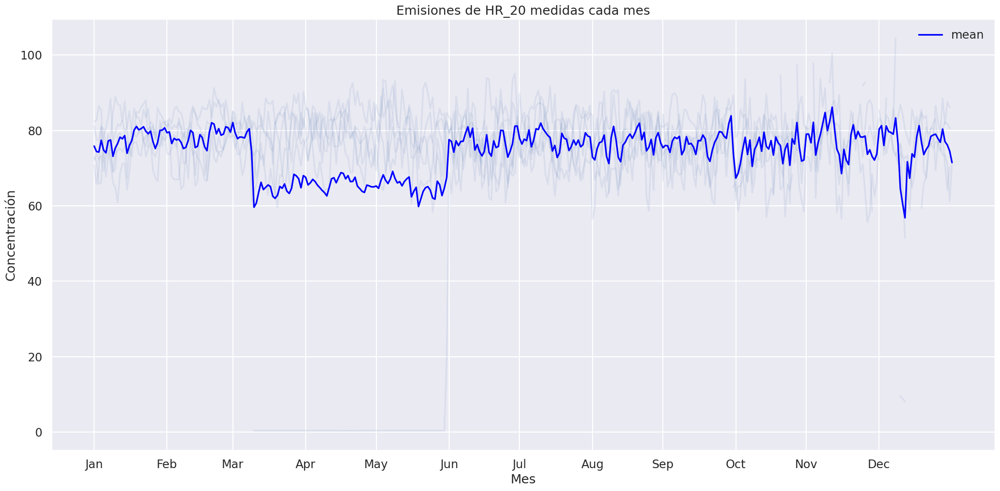

P_20------------------------------------------------------------------------------------------------------------------------------------------------------


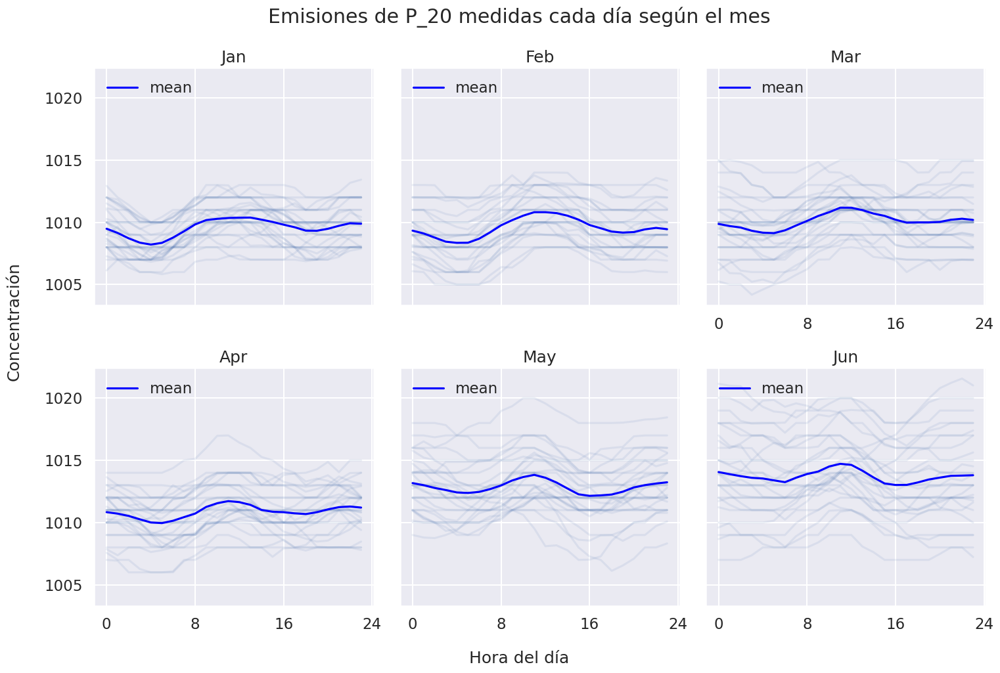

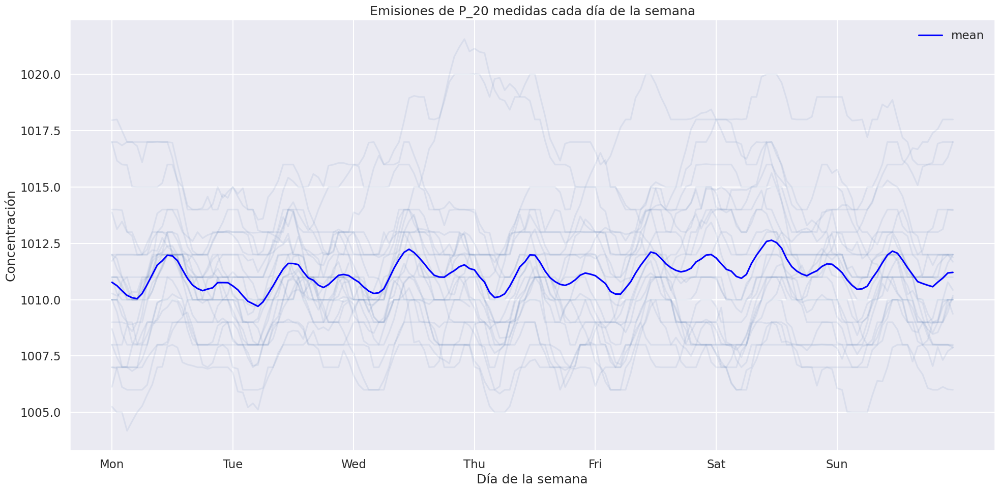

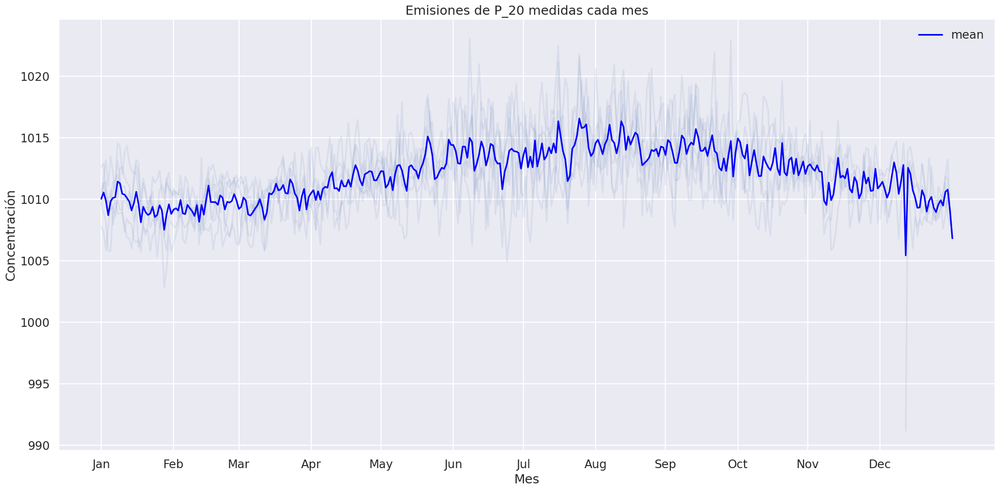

T_diff------------------------------------------------------------------------------------------------------------------------------------------------------


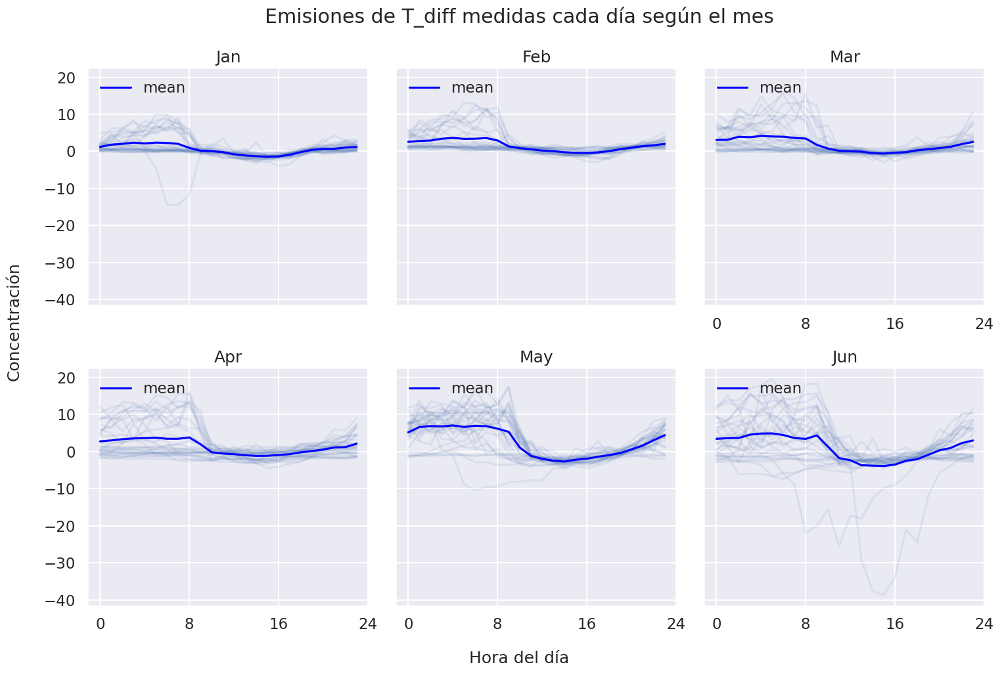

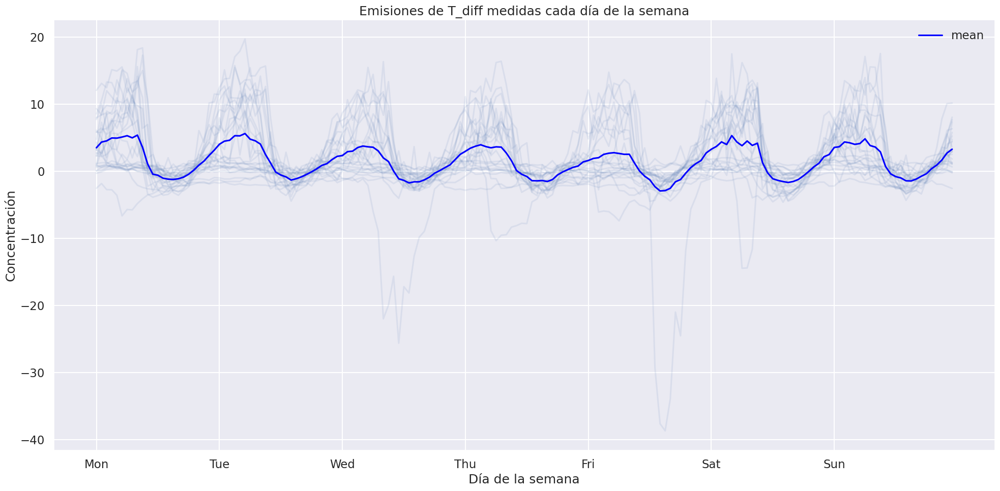

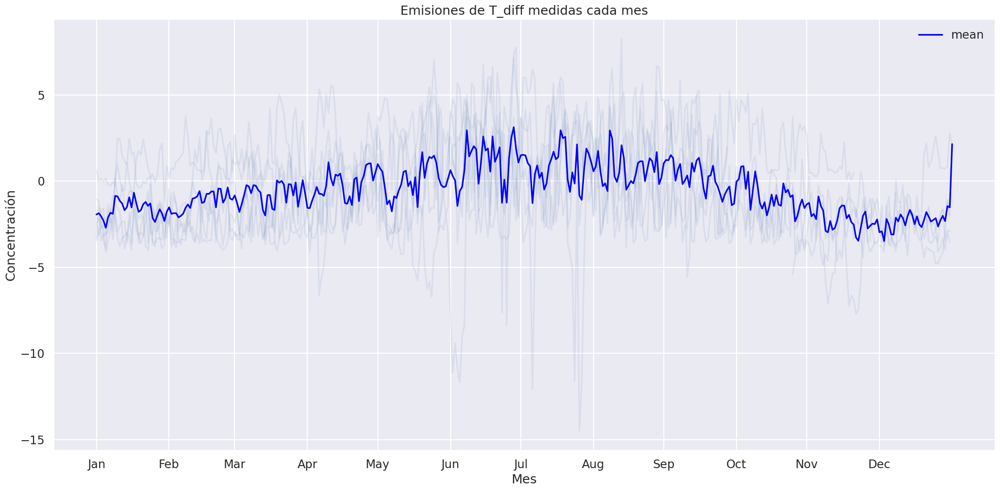

In [38]:
for col in ['T_20', 'WD_20', 'WS_20', 'SigDir_20', 'HR_20', 'P_20', 'T_diff']:
    print(col + '-'*150)
    visualizar_trends(data_df, col = col, ano_0=2021, title=f'Emisiones de {col}')